In [1]:
# !pip install numpy pandas matplotlib seaborn plotly folium

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import folium
import json
from folium import Choropleth

%matplotlib inline

sns.set_style("darkgrid")
matplotlib.rcParams["font.size"] = 14
matplotlib.rcParams["figure.figsize"] = (9, 5)
matplotlib.rcParams["figure.facecolor"] = "#00000000"

In [3]:
df = pd.read_csv('crop_yield.csv')
df.head(2)

,Crop,Crop_Year,Season,State,Area,Production,Annual_Rainfall,Fertilizer,Pesticide,Yield
0,Arecanut,1997,Whole Year,Assam,73814.0,56708,2051.4,7024878.38,22882.34,0.796087
1,Arhar/Tur,1997,Kharif,Assam,6637.0,4685,2051.4,631643.29,2057.47,0.710435


In [4]:
df.shape

(19689, 10)

In [5]:
df.columns

Index(['Crop', 'Crop_Year', 'Season', 'State', 'Area', 'Production',
       'Annual_Rainfall', 'Fertilizer', 'Pesticide', 'Yield'],
      dtype='object')

In [6]:
df[['Area','Production', 'Annual_Rainfall',
       'Pesticide', 'Yield']].corr()

,Area,Production,Annual_Rainfall,Pesticide,Yield
Area,1.000000,0.037441,-0.106054,0.973479,0.001858
Production,0.037441,1.000000,0.029879,0.035171,0.570809
Annual_Rainfall,-0.106054,0.029879,1.000000,-0.097657,0.020761
Pesticide,0.973479,0.035171,-0.097657,1.000000,0.001782
Yield,0.001858,0.570809,0.020761,0.001782,1.000000


*****
Data Analysis Plan for Agricultural Crop Yield in Indian States dataset for below columns \['Crop', 'Crop\_Year', 'Season', 'State', 'Area', 'Production', 'Annual\_Rainfall', 'Fertilizer', 'Pesticide', 'Yield'\] and below value \["Arecanut", "1997", "Whole Year", "Assam", "73814.0", "56708", "2051.4", "7024878.38", "22882.34", "0.796087"\] using chart name

###### ChatGPT said:

ChatGPT

Below is a structured **Data Analysis Plan** for the **Agricultural Crop Yield in Indian States dataset**, considering the provided columns and the example data point you shared. Each step includes methods and visualizations (charts) that can be used to extract insights from the data.

* * *

## **Data Analysis Plan**

### **Objective**

The goal is to analyze the factors influencing agricultural crop yields across Indian states over various years, assessing the relationships between variables like area, production, annual rainfall, fertilizer use, pesticide use, and crop yield.

* * *

### **Dataset Columns**

1.  **Crop**: Type of crop grown.
2.  **Crop\_Year**: Year in which the crop was grown.
3.  **Season**: Season during which the crop was grown (e.g., Whole Year, Kharif, Rabi).
4.  **State**: Indian state where the crop was grown.
5.  **Area**: Area of land (in hectares) cultivated for the crop.
6.  **Production**: Total crop production.
7.  **Annual\_Rainfall**: Average annual rainfall for the region.
8.  **Fertilizer**: Quantity of fertilizer used in production.
9.  **Pesticide**: Quantity of pesticide used in crop cultivation.
10.  **Yield**: Crop yield (amount of production per hectare).
* * *

## **Data Analysis Plan**

### **1\. Data Exploration & Cleaning**

**Objective**: Understand the data, check for missing values, and prepare it for analysis.

#### Steps:

-   **Check Missing Data**:
    -   Identify missing values in the dataset for all columns.
    -   Use imputation strategies (mean/median substitution) or drop rows/columns if necessary.
-   **Data Type Validation**:
    -   Ensure numeric values (like `Area`, `Production`, `Rainfall`, etc.) are correctly formatted as floats/numerical types.

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19689 entries, 0 to 19688
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Crop             19689 non-null  object 
 1   Crop_Year        19689 non-null  int64  
 2   Season           19689 non-null  object 
 3   State            19689 non-null  object 
 4   Area             19689 non-null  float64
 5   Production       19689 non-null  int64  
 6   Annual_Rainfall  19689 non-null  float64
 7   Fertilizer       19689 non-null  float64
 8   Pesticide        19689 non-null  float64
 9   Yield            19689 non-null  float64
dtypes: float64(5), int64(2), object(3)
memory usage: 1.5+ MB


-   **Handle Outliers**:
    -   Check for extreme values in `Yield`, `Area`, and `Production`.
    -   Use visualization methods to identify outliers (box plots).

In [8]:
# fig = px.box(df, y="Yield")
fig = px.box(df, y="Area")
# fig = px.box(df, y="Production")
fig.show()

#### Charts:

-   **Missing Value Heatmap** (e.g., using seaborn `heatmap`)

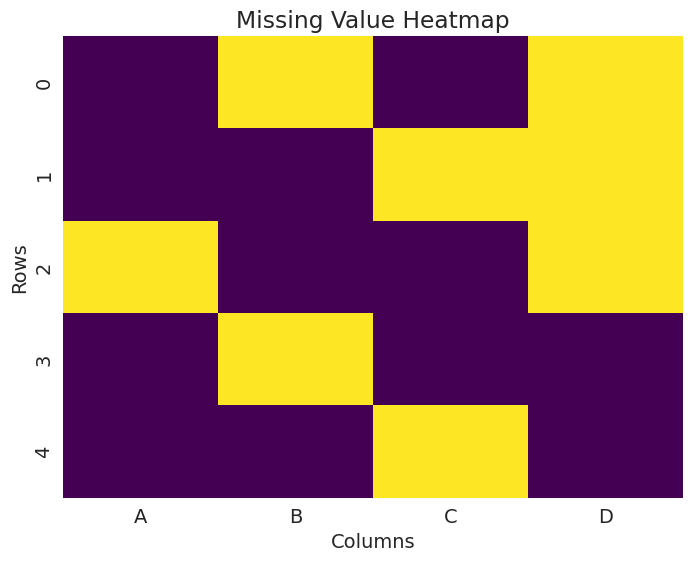

In [9]:
data = {
    'A': [1, 2, None, 4, 5],
    'B': [None, 2, 3, None, 5],
    'C': [1, None, 3, 4, None],
    'D': [None, None, None, 4, 5]
}
df_head = pd.DataFrame(data)
missing_data = df_head.isnull()
plt.figure(figsize=(8, 6))
sns.heatmap(missing_data, cmap='viridis', cbar=False, xticklabels=True, yticklabels=True)
plt.title('Missing Value Heatmap')
plt.xlabel('Columns')
plt.ylabel('Rows')
plt.show()

-   **Box Plot** for detecting outliers in columns such as `Yield`, `Area`, `Annual_Rainfall`.

* * *

### **2\. Descriptive Statistics**

**Objective**: Summarize key statistical properties of the data to establish trends and key metrics.

#### Steps:

-   Compute summary statistics for numerical columns:
    -   Mean, median, standard deviation, min, and max for `Area`, `Production`, `Annual_Rainfall`, `Fertilizer`, `Pesticide`, `Yield`.

In [10]:
df.describe()

,Crop_Year,Area,Production,Annual_Rainfall,Fertilizer,Pesticide,Yield
count,19689.000000,1.968900e+04,1.968900e+04,19689.000000,1.968900e+04,1.968900e+04,19689.000000
mean,2009.127584,1.799266e+05,1.643594e+07,1437.755177,2.410331e+07,4.884835e+04,79.954009
std,6.498099,7.328287e+05,2.630568e+08,816.909589,9.494600e+07,2.132874e+05,878.306193
min,1997.000000,5.000000e-01,0.000000e+00,301.300000,5.417000e+01,9.000000e-02,0.000000
25%,2004.000000,1.390000e+03,1.393000e+03,940.700000,1.880146e+05,3.567000e+02,0.600000
50%,2010.000000,9.317000e+03,1.380400e+04,1247.600000,1.234957e+06,2.421900e+03,1.030000
75%,2015.000000,7.511200e+04,1.227180e+05,1643.700000,1.000385e+07,2.004170e+04,2.388889
max,2020.000000,5.080810e+07,6.326000e+09,6552.700000,4.835407e+09,1.575051e+07,21105.000000


-   Analyze the distribution of these statistics over time or by state.

#### Charts:

-   **Histogram** for `Yield`, `Annual_Rainfall`, `Production`.

In [11]:
fig = px.histogram(df, x="Yield", nbins=10, title="Histogram for Yield", color_discrete_sequence=["skyblue"])
fig.update_layout(xaxis_title="Yield", yaxis_title="Frequency")
fig.show()

In [12]:
fig = px.histogram(df, x="Annual_Rainfall", nbins=10, title="Histogram for Annual Rainfall", color_discrete_sequence=["lightgreen"])
fig.update_layout(xaxis_title="Annual Rainfall", yaxis_title="Frequency")
fig.show()

In [13]:
fig = px.histogram(df, x="Production", nbins=10, title="Histogram for Production", color_discrete_sequence=["lightcoral"])
fig.update_layout(xaxis_title="Production", yaxis_title="Frequency")
fig.show()

-   **Box Plot** for statistical comparisons across states or seasons.

In [14]:
fig = px.box(df, x="State", y="Yield", title="Yield Comparison Across States",
             color="State", boxmode="group")
fig.update_layout(xaxis_title="State", yaxis_title="Yield")
fig.show()

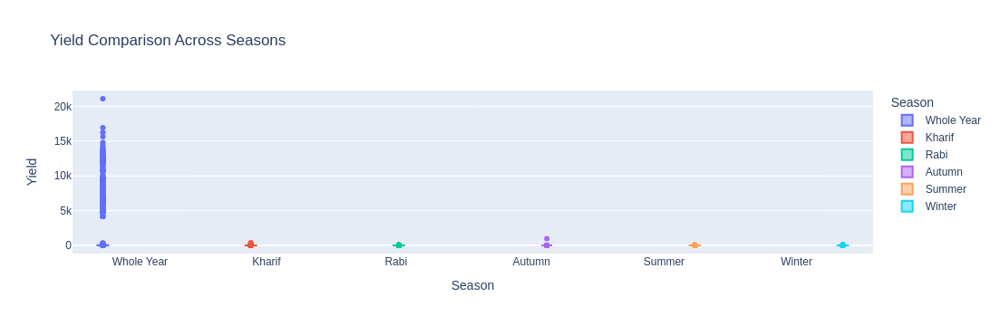

In [15]:
fig = px.box(df, x="Season", y="Yield", title="Yield Comparison Across Seasons",
             color="Season", boxmode="group")
fig.update_layout(xaxis_title="Season", yaxis_title="Yield")
fig.show()

* * *

### **3\. Comparative Analysis by State**

**Objective**: Understand differences across Indian states in terms of crop production, area under cultivation, and crop yield.

#### Steps:

-   Compare **state-wise crop yield**.

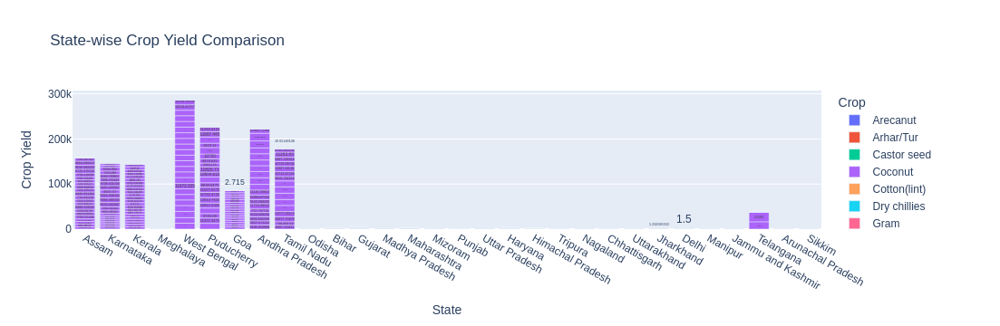

In [20]:
fig = px.bar(df, x='State', y='Yield', color='Crop', title='State-wise Crop Yield Comparison',
             labels={'Yield': 'Crop Yield', 'State': 'State'}, text='Yield')
fig.show()

-   Examine state differences in **fertilizer use**, **annual rainfall**, and **pesticide application**.

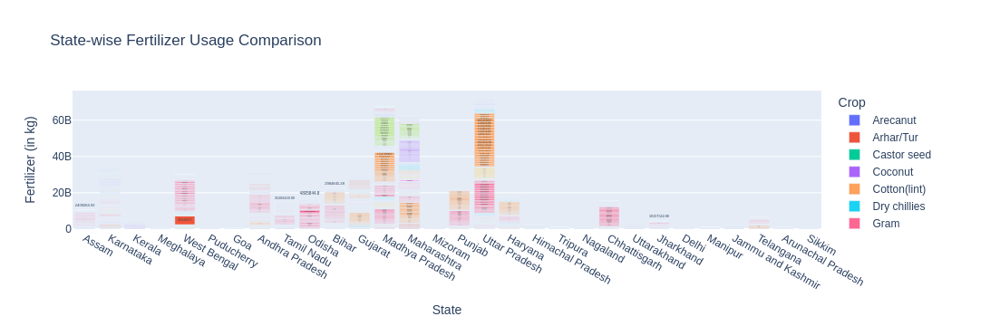

In [21]:
fig_fertilizer = px.bar(df, x='State', y='Fertilizer', color='Crop', 
                        title='State-wise Fertilizer Usage Comparison',
                        labels={'Fertilizer': 'Fertilizer (in kg)', 'State': 'State'}, text='Fertilizer')
fig_fertilizer.show()

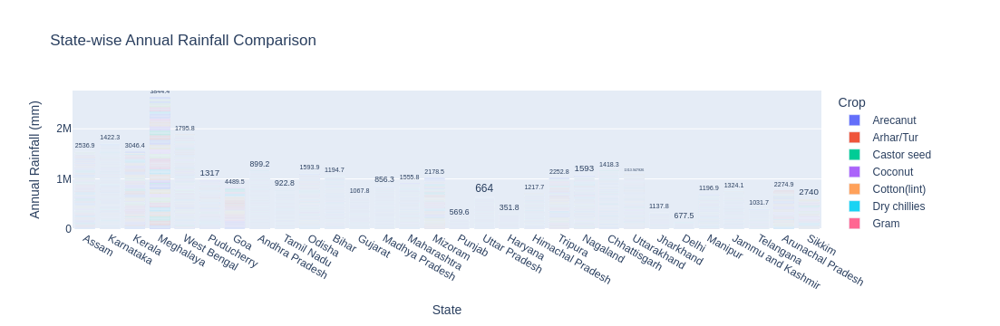

In [22]:
fig_rainfall = px.bar(df, x='State', y='Annual_Rainfall', color='Crop', 
                      title='State-wise Annual Rainfall Comparison',
                      labels={'Annual_Rainfall': 'Annual Rainfall (mm)', 'State': 'State'}, text='Annual_Rainfall')
fig_rainfall.show()

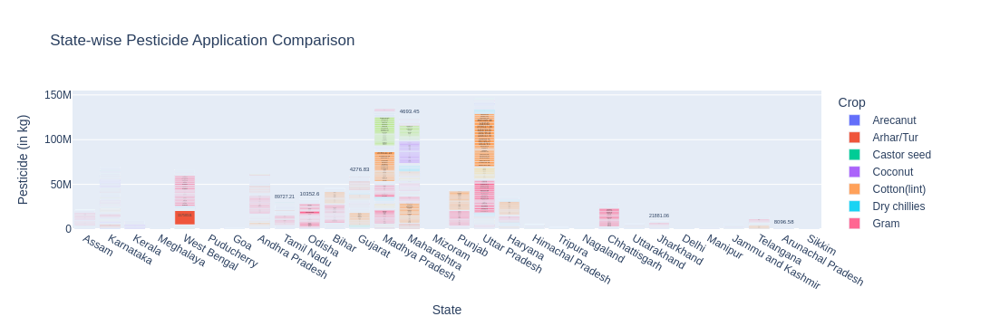

In [23]:
fig_pesticide = px.bar(df, x='State', y='Pesticide', color='Crop', 
                       title='State-wise Pesticide Application Comparison',
                       labels={'Pesticide': 'Pesticide (in kg)', 'State': 'State'}, text='Pesticide')
fig_pesticide.show()

#### Charts:

-   **Bar Chart**: Crop yield by state.

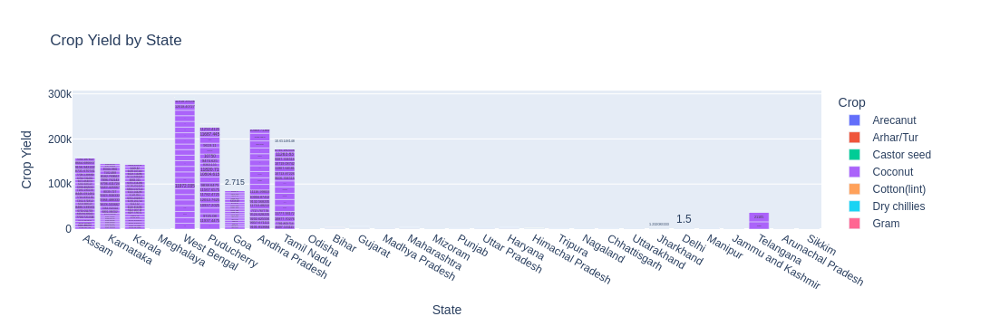

In [24]:
fig = px.bar(df, x='State', y='Yield', color='Crop', 
             title='Crop Yield by State',
             labels={'Yield': 'Crop Yield', 'State': 'State'}, text='Yield')
fig.show()

-   **Heatmap**: Visualize rainfall patterns and their impact on crop yield by state.

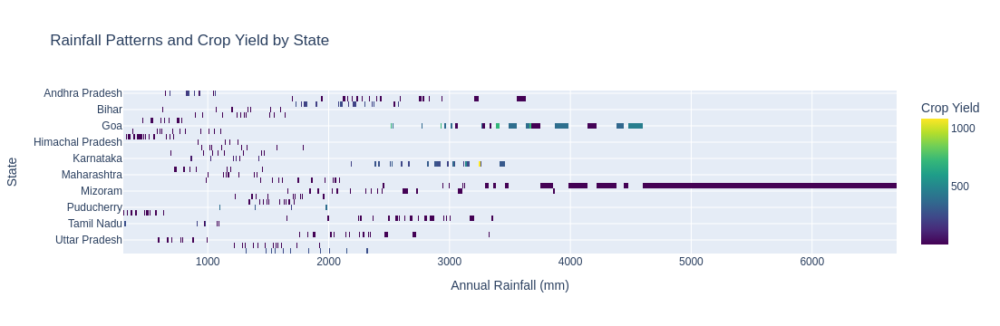

In [28]:
heatmap_data = df.pivot_table(index='State', columns='Annual_Rainfall', values='Yield', aggfunc='mean')
heatmap_data.head(2)
fig = px.imshow(heatmap_data, 
                labels=dict(x="Annual Rainfall (mm)", y="State", color="Crop Yield"),
                title="Rainfall Patterns and Crop Yield by State",
                color_continuous_scale='Viridis')
fig.show()

-   **Stacked Bar Chart**: Compare fertilizer and pesticide use by state.

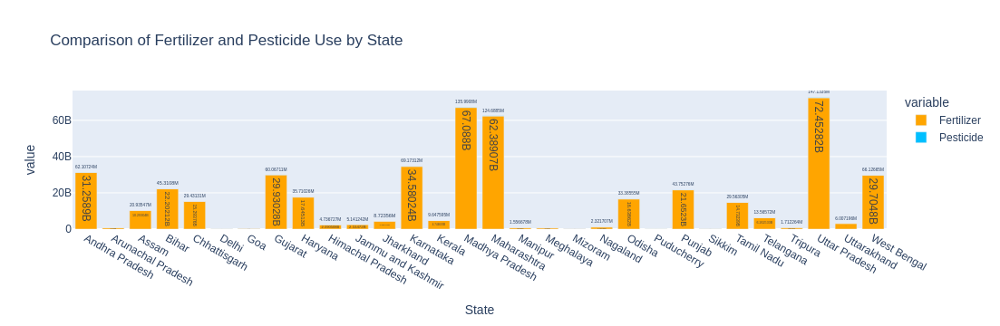

In [29]:
df_filter = df[['State', 'Fertilizer', 'Pesticide']].groupby('State').sum().reset_index()
fig = px.bar(df_filter, 
             x='State', 
             y=['Fertilizer', 'Pesticide'], 
             title='Comparison of Fertilizer and Pesticide Use by State',
             labels={'Fertilizer': 'Fertilizer Usage', 'Pesticide': 'Pesticide Usage', 'State': 'State'},
             color_discrete_sequence=['#FFA500', '#00BFFF'],  # Different colors for Fertilizer and Pesticide
             text_auto=True)
fig.show()

* * *

### **4\. Seasonal & Temporal Trend Analysis**

**Objective**: Investigate how crop yields and other variables change by season and over time.

#### Steps:

-   Analyze crop yield patterns for the seasons (`Whole Year`, `Kharif`, `Rabi`) over the years.
-   Assess trends in production, rainfall, and fertilizer use over the years.

#### Charts:

-   **Line Chart**: Temporal trends in `Yield`, `Fertilizer`, `Pesticide`, and `Annual Rainfall`.

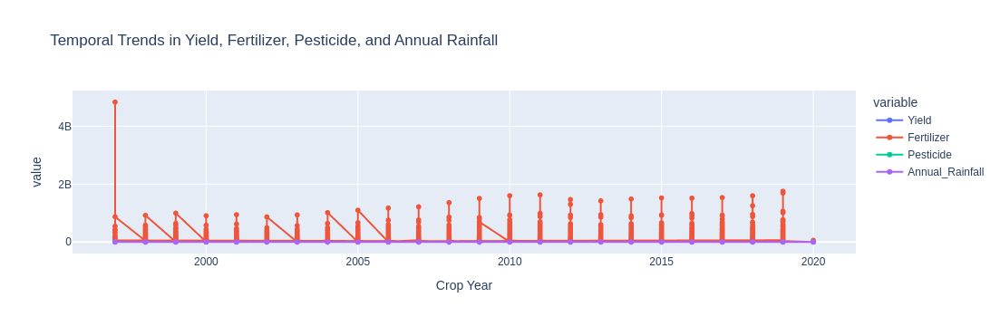

In [30]:
fig = px.line(df, 
              x='Crop_Year', 
              y=['Yield', 'Fertilizer', 'Pesticide', 'Annual_Rainfall'], 
              title='Temporal Trends in Yield, Fertilizer, Pesticide, and Annual Rainfall',
              labels={'Crop_Year': 'Crop Year'},
              markers=True)
fig.show()

-   **Time Series Analysis** for production changes over `Crop_Year`.

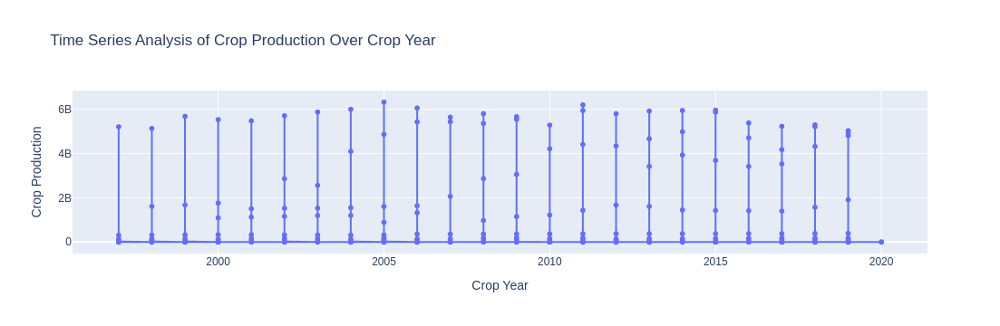

In [31]:
fig = px.line(df, 
              x='Crop_Year', 
              y='Production', 
              title='Time Series Analysis of Crop Production Over Crop Year',
              labels={'Crop_Year': 'Crop Year', 'Production': 'Crop Production'},
              markers=True)
fig.show()

* * *

### **5\. Relationship Analysis**

**Objective**: Explore correlations between independent variables (area, rainfall, fertilizer use, pesticide use) and crop yield.

#### Steps:

-   Perform correlation analysis to assess the linear relationships among variables.
-   Visualize pairwise comparisons.

#### Charts:

-   **Scatter Plot**: Yield vs. Area, Yield vs. Annual Rainfall.

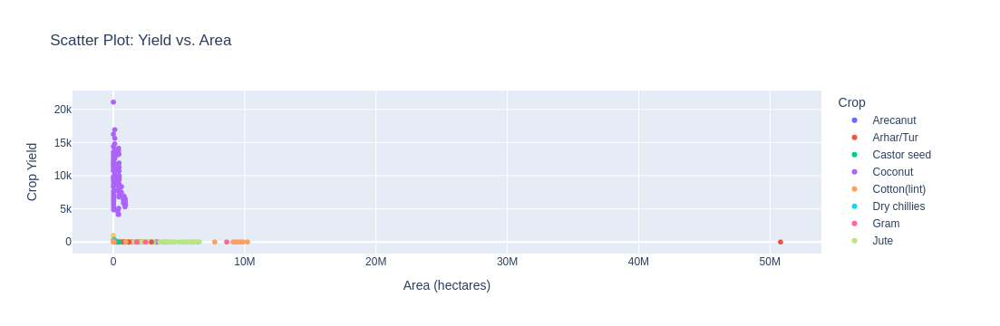

In [32]:
fig1 = px.scatter(df, 
                  x='Area', 
                  y='Yield', 
                  title='Scatter Plot: Yield vs. Area',
                  labels={'Area': 'Area (hectares)', 'Yield': 'Crop Yield'},
                  color='Crop', 
                  hover_data=['State', 'Crop_Year'])
fig1.show()

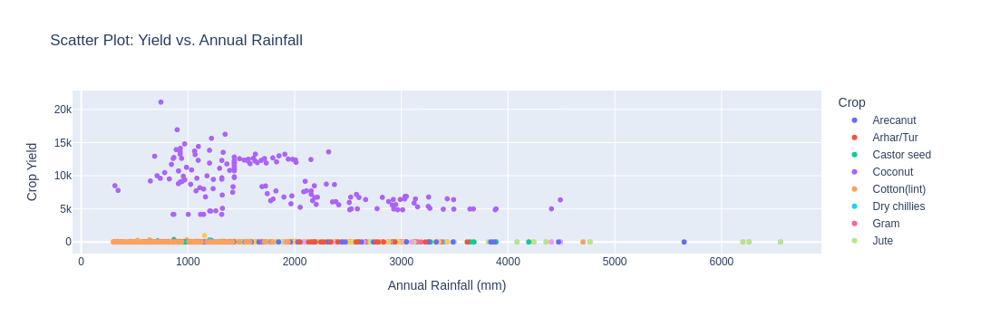

In [33]:
fig2 = px.scatter(df, 
                  x='Annual_Rainfall', 
                  y='Yield', 
                  title='Scatter Plot: Yield vs. Annual Rainfall',
                  labels={'Annual_Rainfall': 'Annual Rainfall (mm)', 'Yield': 'Crop Yield'},
                  color='Crop', 
                  hover_data=['State', 'Crop_Year'])
fig2.show()

-   **Heatmap**: Correlation matrix for numerical variables like `Annual_Rainfall`, `Fertilizer`, `Pesticide`, and `Yield`.

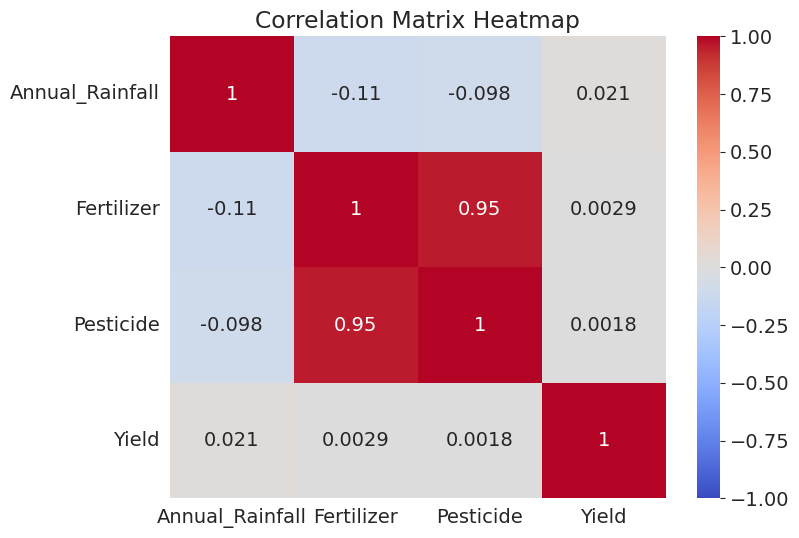

In [34]:
plt.figure(figsize=(8, 6))
df_filter = df[['Annual_Rainfall', 'Fertilizer', 'Pesticide', 'Yield']].corr()
sns.heatmap(df_filter, annot=True, cmap='coolwarm', vmin=-1, vmax=1, center=0)
plt.title('Correlation Matrix Heatmap')
plt.show()

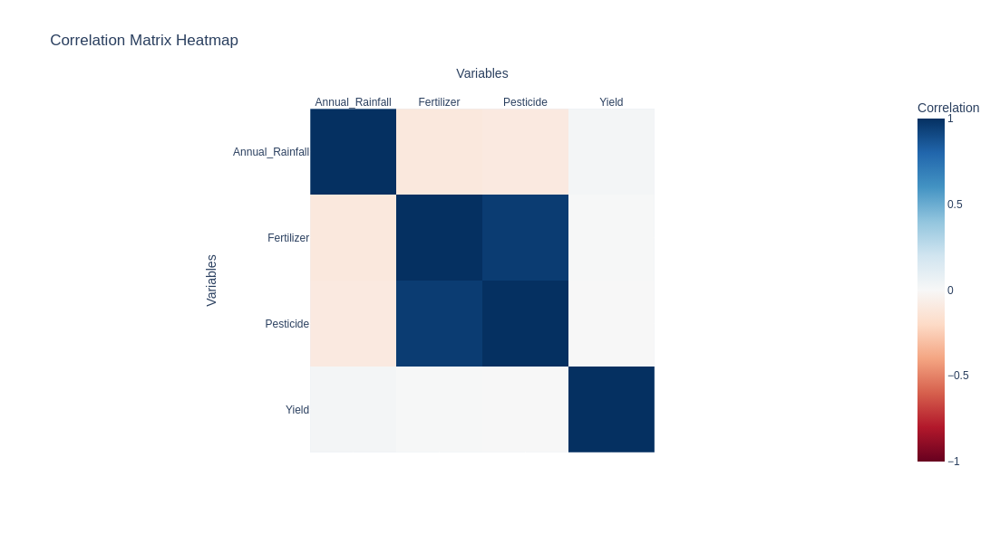

In [48]:
df_filter = df[['Annual_Rainfall', 'Fertilizer', 'Pesticide', 'Yield']].corr()
fig = px.imshow(df_filter, 
    title="Correlation Matrix Heatmap", 
    labels=dict(x="Variables", y="Variables", color="Correlation"), 
    color_continuous_scale="RdBu", 
    width=1200, height=600,
    zmin=-1, zmax=1)
fig.update_xaxes(side="top")
fig.show()

In [16]:
df.head(2)

,Crop,Crop_Year,Season,State,Area,Production,Annual_Rainfall,Fertilizer,Pesticide,Yield
0,Arecanut,1997,Whole Year,Assam,73814.0,56708,2051.4,7024878.38,22882.34,0.796087
1,Arhar/Tur,1997,Kharif,Assam,6637.0,4685,2051.4,631643.29,2057.47,0.710435


* * *

### **6\. Predictive Analysis (Optional)**

If historical patterns or prediction is a goal:

#### Objective:

-   Use machine learning models to predict **crop yield** using features like `Area`, `Rainfall`, `Fertilizer`, and `Pesticide`.

#### Methods:

-   **Linear Regression**, **Random Forest**, or other regression techniques to predict `Yield`.

#### Charts:

-   **Scatter Plot with Regression Line**.
-   **Model Validation Metrics Visualization**: RMSE, MAE plots, or feature importance charts from ML models.
* * *

### **Summary of Suggested Charts**

| **Analysis Objective** | **Visualization** |
| --- | --- |
| Data Exploration | Missing Value Heatmap, Box Plots |
| Descriptive Statistics | Histogram, Box Plot |
| Comparative State Analysis | Bar Chart, Heatmap, Stacked Bar Chart |
| Temporal & Seasonal Trends | Line Chart, Time Series Analysis |
| Relationship Analysis | Scatter Plot, Heatmap |
| Predictive Analysis (Optional) | Scatter Plot with Regression Line, Feature Importance Chart |

* * *

### **Tools/Packages to Use**

1.  **Python Libraries**:
    -   **Pandas**: Data manipulation.
    -   **NumPy**: Numerical analysis.
    -   **Matplotlib & Seaborn**: Visualization.
    -   **Scikit-learn**: Machine learning (if predictive analysis is needed).
2.  **Visualization Packages**:
    -   **Matplotlib**: For general plotting.
    -   **Seaborn**: For statistical visualizations like heatmaps and boxplots.
    -   **Plotly**: For interactive visualizations if needed.
* * *

### Next Steps

1.  **Load the Data** into a dataframe and clean/preprocess.
2.  Perform **Exploratory Data Analysis (EDA)** to derive insights with visualization tools.
3.  Plan predictive models (if the goal includes forecasting crop yields).

Let me know if you would like code examples or assistance with any step above!